### Generating QPO Audio Files using Mind the Gaps & Strauss

Exposure cadence: 3.0252100840336134 d


/home/smangham/projects/sonification-zooniverse-preproto/.venv/lib/python3.12/site-packages/stingray/utils.py:403: UserWarning: SIMON says: Stingray only uses poisson err_dist at the moment. All analysis in the light curve will assume Poisson errors. Sorry for the inconvenience.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)


Text(0.5, 0, 'Time (s)')

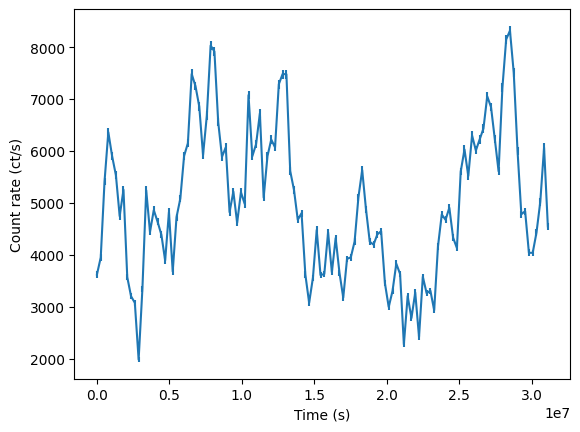

In [1]:
from mind_the_gaps.models.psd_models import Lorentzian as Lor
from mind_the_gaps.models.psd_models import SHO
from mind_the_gaps.models.psd_models import BendingPowerlaw

from mind_the_gaps.simulator import Simulator
import matplotlib.pyplot as plt
import numpy as np

from astropy.modeling import Model
from astropy.units import Quantity
from astropy import units as u

from numpy.typing import NDArray
from typing import Type


CAMPAIGN_LENGTH: Quantity = 360 * u.day
EXPOSURE_COUNT: int = 120
EXPOSURE_LENGTH: Quantity = 1 * u.s

exposure_times: Quantity = np.linspace(0, CAMPAIGN_LENGTH, EXPOSURE_COUNT).to(u.s)
exposure_cadence: Quantity = exposure_times[1] - exposure_times[0]
print(f"Exposure cadence: {exposure_cadence.to(u.day)}")


exposures: NDArray[float] = EXPOSURE_LENGTH.value * np.ones(EXPOSURE_COUNT)  # higher = better (i.e. less poisson noise), original = 5 
# Length of sample in seconds, we can leave at 1 and just adjust the mean

COUNT_RATE_MEAN: Quantity = 5000 / u.s  # higher = better (i.e. less poisson noise), original = 50
# Baseline rate in the simulator

VARIANCE_FACTOR: float = 0.3  # Variance / mean, goes as high as 0.5 in AGN
VARIANCE: Quantity = VARIANCE_FACTOR**2 * COUNT_RATE_MEAN**2  # Amplitude, will affect dominance when multiple models combined
# By defining relative to the mean it makes it easier to understand/set ratios

QPO_PERIOD: Quantity = 15 * u.day

angular_frequency = 2 * np.pi / QPO_PERIOD.to(u.s) # angular freq
Q = 5 # coherence higher = more periodic, original = 5

lorentzian_model = Lor(
    S0=VARIANCE.value, 
    omega0=angular_frequency.value, 
    Q=Q,
)
sho_model = SHO(
    S0=VARIANCE.value, 
    omega0=angular_frequency.value, 
    Q=Q,
)
bpl_model = BendingPowerlaw(
    S0=VARIANCE.value, 
    omega0=angular_frequency.value, 
    Q=Q,
)  # This is a damped random walk, so no actual periodic element
# Can combine with Lorentzian, probably want to dial up and down variances of each

simulator = Simulator(
    bpl_model, 
    exposure_times.value, 
    exposures, 
    mean=COUNT_RATE_MEAN.value, 
    pdf="Gaussian", 
    extension_factor=2
)
countrates = simulator.generate_lightcurve()
noisy_countrates, uncertainties = simulator.add_noise(countrates)
plt.errorbar(
    exposure_times, noisy_countrates, yerr=uncertainties
)
plt.ylabel("Count rate (ct/s)")
plt.xlabel("Time (s)")

## Generating Lightcurves

We want to generate a series of lightcurves to be sonified, in the style of a 'plausible' QPO.
We'll store them 

### Defining Functions
We wrap up lightcurve generation in a function in order to make it easier to repeat. 
A lightcurve can be built from one or more models, all added together (Astropy models add nicely).

In order for the fractional variation to work, we defer actually *instantiating* the model,
which means you have to pass the type and parameters through to the generation function.

The data on how a lightcurve is build should also be stored as metadata on the **AstroPy** `Table`.

> Why isn't this a TimeSeries?

Because those want actual `datetime`s, and this is currently just arbitrary time.

In [18]:
from typing import Dict, List

from numpy.typing import NDArray
import numpy as np
from astropy.modeling import Model
from astropy.units import Quantity
from astropy.table import QTable
from mind_the_gaps.simulator import Simulator


def generate_model_from_dict(
        model: Dict[str, any],
        counts_mean: Quantity,
) -> Model:
    """
    Generates a model from a dictionary that describes it.

    :param model: A dictionary that describes an Astropy model,
        containing `type` (as a base type), `period` (as a quantity), and
        `coherence` and `variance_fraction`.
        Arguably should be unpacked for this function, or made into a dataclass
    :param counts_mean: The mean x-ray count rate, in 1/time units
    """
    return model['type'](
        omega0=2 * np.pi / model['period'].to(u.s).value,
        Q=model['coherence'],
        S0=model['variance_fraction']**2 * counts_mean.to(1/u.s).value**2,
    )


def generate_lightcurve(
        campaign_length: Quantity,
        model: Dict[str, any] | List[Dict[str, any]],
        counts_mean: Quantity,
        observation_count: int|None = None,
        observation_cadence: Quantity|None = None
) -> QTable:
    """
    Generates a lightcurve of a given model over a specified time.

    :param model: A dictionary, or list of dictionaries, that describe Astropy models
    :param campaign_length: Length of the observation campaign, in time units
    :param counts_mean: The mean x-ray count rate, in 1/time units
    :param observation_count: Number of observations to generate
    :param observation_cadence: Spacing of observations, in time units
    :return: An astropy table, with quantities, corresponding to the lightcurve
    """
    if not isinstance(model, list):
        model = [model]

    if not observation_count:
        observation_count = int(campaign_length / observation_cadence)

    times: NDArray[np.floating] = np.linspace(
        0, campaign_length.to(u.s), observation_count
    )
    counts: NDArray[np.floating] = np.ones_like(times)

    model_components: List[Model] = [
        generate_model_from_dict(
            model_component, counts_mean,
        ) for model_component in model
    ]

    meta: Dict[str, any] = {}
    for model_component in model:
        for key in model_component.keys():
            meta[key] = meta.get(key, []) + [model_component[key]]

    model_total: Model = model_components[0]
    for model_component in model_components[1:]:
        model_total += model_component

    simulator: Simulator = Simulator(
        model_total, 
        times.value, 
        counts.value, 
        mean=counts_mean.value, 
        pdf="Gaussian", 
        extension_factor=2
    )
    counts_clean: NDArray[np.floating] = simulator.generate_lightcurve()
    counts_noisy, uncertainties = simulator.add_noise(counts_clean)
    return QTable(
        {
            'time': times,
            "count": counts_noisy * counts_mean.unit, 
            "uncertainty": uncertainties * counts_mean.unit,
        },
        meta=meta,
    )  

## Specifying Models

Once we've got the function set up, we want to create some 'basic' light curves - in this case:
* A pure Bending Powerlaw red noise 'null' light curve with no QPO.
* A pure Lorentzian light curve.
* A mixture of Lorentzian signal and Bending Powerlaw red noise, as a 'realistic' QPO.

These are configured with period, coherence (`Q`), and the fraction of the mean value the variance should cover;
i.e., if the lightcurve has a mean value of 50 counts/second, 
then a variance of 0.2 corresponds to a range of -20 to +20 on the model component.

The coherence is apparently a measure of how coherent variation is (ask Andres!).
We can tune the level of noise by tweaking the mean counts per second, to tweak the Poisson noise.

As this can take a few minutes, we pickle the outputs to save time when re-running.

### Relative Specification

Arguably, this should be specified in terms of ratios, rather than real values;
i.e. measurements/period, periods/campaign, % error. 
From those settings, the period e.t.c. could be reverse-engineered.

For the moment, we're going with 'real' values in order to make it easier to produce realistic light curves.

In [3]:
from astropy import units as u
from astropy.table import QTable
from mind_the_gaps.models.psd_models import Lorentzian, SHO, BendingPowerlaw
import pickle


lightcurve_bpl: QTable = generate_lightcurve(
    campaign_length=360 * u.day, observation_cadence=3 * u.day, counts_mean=50 / u.second,
    model={'type': BendingPowerlaw, 'period': 15 * u.day, 'coherence': 5, 'variance_fraction': 0.3},
)

lightcurve_lorentzian: QTable = generate_lightcurve(
    campaign_length=360 * u.day, observation_cadence=3 * u.day, counts_mean=50 / u.second,
    model={'type': Lorentzian, 'period': 15 * u.day, 'coherence': 5, 'variance_fraction': 0.3},
)

lightcurve_mixed: QTable = generate_lightcurve(
    campaign_length=360 * u.day, observation_cadence=3 * u.day, counts_mean=50 / u.second,
    model=[
        {'type': BendingPowerlaw, 'period': 15 * u.day, 'coherence': 5, 'variance_fraction': 0.2},
        {'type': Lorentzian, 'period': 15 * u.day, 'coherence': 5, 'variance_fraction': 0.2},
    ],
)


with open("lightcurve_bpl.pickle", "wb") as pickle_file:
    pickle.dump(lightcurve_bpl, pickle_file)

with open("lightcurve_lorentzian.pickle", "wb") as pickle_file:
    pickle.dump(lightcurve_lorentzian, pickle_file)

with open("lightcurve_mixed.pickle", "wb") as pickle_file:
    pickle.dump(lightcurve_mixed, pickle_file)

/home/smangham/projects/sonification-zooniverse-preproto/.venv/lib/python3.12/site-packages/stingray/utils.py:403: UserWarning: SIMON says: Stingray only uses poisson err_dist at the moment. All analysis in the light curve will assume Poisson errors. Sorry for the inconvenience.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
/home/smangham/projects/sonification-zooniverse-preproto/.venv/lib/python3.12/site-packages/stingray/utils.py:403: UserWarning: SIMON says: Stingray only uses poisson err_dist at the moment. All analysis in the light curve will assume Poisson errors. Sorry for the inconvenience.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)


In [7]:
import pickle


with open("lightcurve_bpl.pickle", "rb") as pickle_file:
    lightcurve_bpl: QTable = pickle.load(pickle_file)

with open("lightcurve_lorentzian.pickle", "rb") as pickle_file:
    lightcurve_lorentzian: QTable = pickle.load(pickle_file)

with open("lightcurve_mixed.pickle", "rb") as pickle_file:
    lightcurve_mixed: QTable = pickle.load(pickle_file)

### Plotting Lightcurves

We'll visualise the light curves to ensure they're not completely wrong. 
We want to automate this, and so write some Plotly code to generate a light curve with title from the metadata on the Table.

In [92]:
from typing import List, Dict
from astropy.table import QTable
from astropy import units as u

from plotly.graph_objects import Figure, Scatter


def metadata_to_title(
        meta: Dict[str, List[str]],
) -> str:
    """
    Given the metadata dictionary from one of the tables we generate earlier,
    produces a plot title from it.

    :param meta: The metadata dictionary, containing the keys
        `type`, `period` and `variance_fraction`
    :return: A string title describing the base model and its properties
    """
    return ' & '.join(
        [
            f"{model_type}, period {period.to(u.day)}, variance fraction of mean {variance_fraction}" for model_type, period, variance_fraction in zip(
                meta['type'], meta['period'], meta['variance_fraction']
            )
        ] 
    )


def plot_generated_lightcurve(
        lightcurve: QTable, time_units: u.UnitBase = u.day, count_units: u.UnitBase = u.second**-1,
        observations_only: bool = False,
) -> Figure:
    """
    Given a generated lightcurve, plots it (with uncertainty regions).


    :param lightcurve: The lightcurve table to plot
    :param title: The title for the plot
    :param time_units: What units to show the time axis in, default days
    :param count_units: What units to show the count rate in, default per second
    :param observations_only: Whether to show the actual observations only
    """
    figure: Figure = Figure(
        data=[
            Scatter(
                x=lightcurve["time"].to(time_units), 
                y=lightcurve["count"].to(count_units), showlegend=False,
            ),
            Scatter(
                x=lightcurve["time"].to(time_units), 
                y=(lightcurve["count"]+lightcurve["uncertainty"]).to(count_units), showlegend=False,
                line_width=0,
            ),
            Scatter(
                x=lightcurve["time"].to(time_units), 
                y=(lightcurve["count"]-lightcurve["uncertainty"]).to(count_units), showlegend=False,
                line_width=0, fill="tonexty", fillcolor="rgba(99,110,250,0.25)",
            )
        ] if not observations_only else [
            Scatter(
                x=lightcurve["time"].to(time_units),
                y=lightcurve["count"].to(count_units),
                mode="markers",
            )
        ],
        layout={
            "title": metadata_to_title(lightcurve.meta),
            "xaxis_title": f"Time ({time_units})",
            "yaxis_title": f"Count rate ({count_units})"
        }
    )
    figure.show("jupyterlab")
    return figure

In [93]:
from plotly.graph_objects import Figure
import plotly.io as pio
pio.renderers.default='iframe'

plot_bpl: Figure = plot_generated_lightcurve(lightcurve_bpl)
plot_lorentzian: Figure = plot_generated_lightcurve(lightcurve_lorentzian)
plot_lorentzian: Figure = plot_generated_lightcurve(lightcurve_mixed)

# Sonification

## Discrete

We can represent the value of each observation as a discrete note from an instrument,
with pitch dependent on the count rate.

### Soundfonts

Fortunately, it's easy to use a variety of instruments with Soundfonts.
We load the Soundfont files from the repository.
The Strauss tutorial recommends them from this [_Soundfonts 4 U_](https://sites.google.com/site/soundfonts4u/) website.

The guitar soundfont has a bunch of different presets - we can list them by creating one without `sf_preset`, but for this use we're specifying `16` - 'Jazz guitar'.
Presets 2 & 8 have weird issues with low notes.

In [105]:
from pathlib import Path
from strauss.generator import Sampler


SOUNDFONT_DIR: Path = Path("../data/soundfonts")

flute_sampler: Sampler = Sampler(SOUNDFONT_DIR / "flute.sf2")
guitar_sampler = Sampler(SOUNDFONT_DIR / "guitars.sf2", sf_preset=16)
violin_sampler = Sampler(SOUNDFONT_DIR / "Strings-4U-v1.0.sf2", sf_preset=1)
piano_sampler = Sampler(SOUNDFONT_DIR / "Nice-Steinway-Lite-v3.0.sf2", sf_preset=1)

Following the format suggested in the STRAUSS tutorials,
we copy the 'base' instruments and tweak them to suit our needs.

We want to trial short and long flute notes.

In [80]:
import copy


flute_sampler_staccato: Sampler = copy.copy(flute_sampler)
flute_sampler_staccato.load_preset('staccato')

flute_sampler_long: Sampler = copy.copy(flute_sampler)
flute_sampler_long.modify_preset(
    {
        'note_length':0.15, # hold each note for 0.03 seconds or 30 ms - what if this was 1s?
        'volume_envelope': {
            'use':'on',
            # A,D,R values in seconds, S sustain fraction from 0-1 that note
            # will 'decay' to (after time A+D)
            'A':0.01,  # ✏️ Time to fade in note to maximum volume, using 10 ms
            'D':0.0,   # ✏️ Time to fall from maximum volume to sustained level (s), irrelevant while S is 1
            'S':1.,    # ✏️ fraction of maximum volume to sustain note at while held, 1 implies 100%
            'R':0.07,  # ✏️ Time to fade out once note is released, using 100 ms
        }
    }
)

### Generation Functions

With the instruments loaded, we then set up the code to convert them into a sonification.

We'll do them in the scale suggested in the Strauss examples; 'C-Major pentatonic'.
This seems to provide a good range of pitches.
Ballparking it at 20 seconds seems OK.


#### Relative Specification
Once the basic outline of this process is nailed down,
we could switch to defining the audio files in terms of notes/second,
which would then scale duration automatically.

We don't really know what the optimal rate is yet.

In [16]:
from typing import List, Tuple, Dict
from astropy.table import QTable
from numpy import floating
from numpy.typing import NDArray
from strauss.score import Score
from strauss.generator import Sampler
from strauss.sources import Objects, Events
from strauss.sonification import Sonification


# C-Major pentatonic, from Strauss example
NOTE_SCALE: List[List[str]] = [
    ["C3","D3","E3","G3","B3","C4","D4","E4","G4","B4","C5","D5","E5","G5","B5"]
]
SOUND_DURATION = 20  # Seconds


def generate_sonification_from_lightcurve(
    table: QTable,
    sampler: Sampler,
):
    system: str = "mono"
    score: Score =  Score(NOTE_SCALE, SOUND_DURATION)
    maps: Dict[str, NDArray[floating]] = {
        'time': table['time'].value,
        'pitch': table['count'].value,
    }

    lims: Dict[str, Tuple[str, str]] = {
        'time': ('0','105'),
        'pitch': ('0','100')
    }
    # set 0 to 100 percentile limits so the full pitch range is used...
    # setting 0 to 105 for time means the sonification is 5% longer than
    # the time needed to trigger each note - by making this more than 100%
    # we give all the notes time to ring out (setting this at 100% means
    # the final note is triggered at the moment the sonification ends)

    # set up source
    sources: Events = Events(maps.keys())
    sources.fromdict(maps)
    sources.apply_mapping_functions(map_lims=lims)

    soni: Sonification = Sonification(score, sources, sampler, system)
    soni.render()
    dobj = soni.notebook_display(show_waveform=0)

### Discrete Lightcurves

As a test, we sonify the Bending Powerlaw noise lightcurve and also plot it with purely observations,
in order to get a better idea of what actual notes are playing.

In [106]:
plot_generated_lightcurve(lightcurve_bpl, observations_only=True)

print("Staccato flute:")
generate_sonification_from_lightcurve(lightcurve_bpl, flute_sampler_staccato)

print("Longer flute:")
generate_sonification_from_lightcurve(lightcurve_bpl, flute_sampler_long)

print("Default guitar:")
generate_sonification_from_lightcurve(lightcurve_bpl, guitar_sampler)

print("Default violin:")
generate_sonification_from_lightcurve(lightcurve_bpl, violin_sampler)

print("Default piano:")
generate_sonification_from_lightcurve(lightcurve_bpl, piano_sampler)

Staccato flute:


Longer flute:


Default guitar:


Default violin:


Default piano:


The default violin sounds are waaay too long!
The longer flute is also a bit much unless we make sure the sounds don't bleed into each other -
if we have a duration higher than 1/notes per second, it goes a bit ghostly.

Best 3 are probably:
* Longer flute (now tuned down)
* Jazz guitar
* Piano

## Continuous

We can *also* represent the data as a continuously-changing pitch.

This actually turns out to be a lot harder than I'd thought.
The default Strauss example uses this data:

In [33]:
import plotly.express as px

# seed the randoms...
np.random.seed(0)

# construct arrays of size N for x and y...
N = 300
pitchshift_x = np.linspace(0,1,N)
pitchshift_y = np.zeros(N)

# define a Gaussian function...
gauss = lambda x, m, s: np.exp(-(pitchshift_x-m)**2/s)

# place some randomised gaussians...
for i in range(10):
    a,b,c = np.random.random(3)
    pitchshift_y += gauss(
        pitchshift_x, b, 1e-3*c
    ) * a ** 3

# now add some noise and normalise
pitchshift_y += np.random.random(N) * pitchshift_y.mean()
pitchshift_y /= pitchshift_y.max()*1.2
pitchshift_y += 0.15

px.line(
    x=pitchshift_x, y=pitchshift_y,
)

This data is then sonified as:

In [39]:
from strauss.score import Score
from strauss.sonification import Sonification
from strauss.sources import Objects, Events
from strauss.generator import Synthesizer


# specify audio system (e.g. mono, stereo, 5.1, ...)
system = "mono"

# length of the sonification in s
length = 15.

# set up synth and turn on LP filter
generator = Synthesizer()
generator.load_preset('pitch_mapper')
generator.preset_details('pitch_mapper')
notes = [["A2"]]
score =  Score(notes, length)

data = {
    'pitch':1.,
    'time_evo':pitchshift_x,
    'pitch_shift':pitchshift_y**0.7
}

# set up source
sources = Objects(data.keys())
sources.fromdict(data)
sources.apply_mapping_functions()

soni = Sonification(score, sources, generator, system)
soni.render()
soni.notebook_display(show_waveform=0)

pitch_mapper:
preset for mapping pitch_shift for 1D data sonification. the single triangle wave oscillator provides a balance between harmonic richness and the harshness of the sound to allow clear audiability over a large pitch range.



In [74]:
# construct arrays of size N for x and y...

# now add some noise and normalise
modified_x = lightcurve_bpl['time'].value
modified_x = modified_x - modified_x.min()
modified_x /= modified_x.max()
modified_y = 0.15 + lightcurve_bpl['count'].value * 1.2 / lightcurve_bpl['count'].value.max()

px.line(
    x=modified_x, y=modified_y,
)

In [75]:
# specify audio system (e.g. mono, stereo, 5.1, ...)
system = "mono"

# length of the sonification in s
length = 15.

# set up synth and turn on LP filter
generator = Synthesizer()
generator.load_preset('pitch_mapper')
generator.preset_details('pitch_mapper')
notes = [["C2"]]
score =  Score(notes, length)

data = {
    'pitch':1.,
    'time_evo':np.linspace(0, 1, len(modified_y)),
    'pitch_shift':modified_y**0.7,
}

# set up source
sources = Objects(data.keys())
sources.fromdict(data)
sources.apply_mapping_functions()

soni = Sonification(score, sources, generator, system)
soni.render()
soni.notebook_display(show_waveform=0)

pitch_mapper:
preset for mapping pitch_shift for 1D data sonification. the single triangle wave oscillator provides a balance between harmonic richness and the harshness of the sound to allow clear audiability over a large pitch range.

